In [ ]:
import sqlite3
import pandas as pd
!pip install geopandas
import geopandas as gpd
import numpy as np
!pip install folium
import folium
!pip install pyspark
import pyspark
import matplotlib.pyplot as plt
from folium.plugins import HeatMap
from pyspark.sql.window import Window
import pyspark.sql.functions as f

     |████████████████████████████████| 1.0 MB 16.9 MB/s 
     |████████████████████████████████| 6.3 MB 38.1 MB/s 
     |████████████████████████████████| 15.4 MB 3.3 MB/s 
     |████████████████████████████████| 281.3 MB 38 kB/s 
     |████████████████████████████████| 198 kB 37.4 MB/s 
  Created wheel for pyspark: filename=pyspark-3.2.0-py2.py3-none-any.whl size=281805912 sha256=da3d6948e231337125c4e7f4285b1720ad8e19c013aaa5531c553ec581d84ee1
  Stored in directory: /root/.cache/pip/wheels/0b/de/d2/9be5d59d7331c6c2a7c1b6d1a4f463ce107332b1ecd4e80718
Successfully built pyspark


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
connection = sqlite3.connect('drive/MyDrive/FPA_FOD_20170508.sqlite')
data = pd.read_sql_query('SELECT * FROM Fires', connection)
pd.set_option('max_columns', None)





In [ ]:
data2 = data[['FIRE_SIZE', 'DISCOVERY_DOY', 'STAT_CAUSE_DESCR']]

data = data[['FIRE_NAME', 'FIRE_YEAR', 
         'SOURCE_REPORTING_UNIT_NAME', 'STAT_CAUSE_DESCR',
         'FIRE_SIZE', 'LATITUDE',
         'LONGITUDE', 'STATE']]



x = len(data)
data.head()

,FIRE_NAME,FIRE_YEAR,SOURCE_REPORTING_UNIT_NAME,STAT_CAUSE_DESCR,FIRE_SIZE,LATITUDE,LONGITUDE,STATE
0,FOUNTAIN,2005,Plumas National Forest,Miscellaneous,0.10,40.036944,-121.005833,CA
1,PIGEON,2004,Eldorado National Forest,Lightning,0.25,38.933056,-120.404444,CA
2,SLACK,2004,Eldorado National Forest,Debris Burning,0.10,38.984167,-120.735556,CA
3,DEER,2004,Eldorado National Forest,Lightning,0.10,38.559167,-119.913333,CA
4,STEVENOT,2004,Eldorado National Forest,Lightning,0.10,38.559167,-119.933056,CA


In [ ]:
spark = pyspark.sql.SparkSession.builder\
        .master('local[*]')\
        .appName('yr2145_hw2 notebook')\
        .getOrCreate()
        

In [ ]:
sparkdf =spark.createDataFrame(data) 
sparkdf.head(5)

[Row(FIRE_NAME='FOUNTAIN', FIRE_YEAR=2005, SOURCE_REPORTING_UNIT_NAME='Plumas National Forest', STAT_CAUSE_DESCR='Miscellaneous', FIRE_SIZE=0.1, LATITUDE=40.03694444, LONGITUDE=-121.00583333, STATE='CA'),
 Row(FIRE_NAME='PIGEON', FIRE_YEAR=2004, SOURCE_REPORTING_UNIT_NAME='Eldorado National Forest', STAT_CAUSE_DESCR='Lightning', FIRE_SIZE=0.25, LATITUDE=38.93305556, LONGITUDE=-120.40444444, STATE='CA'),
 Row(FIRE_NAME='SLACK', FIRE_YEAR=2004, SOURCE_REPORTING_UNIT_NAME='Eldorado National Forest', STAT_CAUSE_DESCR='Debris Burning', FIRE_SIZE=0.1, LATITUDE=38.98416667, LONGITUDE=-120.73555556, STATE='CA'),
 Row(FIRE_NAME='DEER', FIRE_YEAR=2004, SOURCE_REPORTING_UNIT_NAME='Eldorado National Forest', STAT_CAUSE_DESCR='Lightning', FIRE_SIZE=0.1, LATITUDE=38.55916667, LONGITUDE=-119.91333333, STATE='CA'),
 Row(FIRE_NAME='STEVENOT', FIRE_YEAR=2004, SOURCE_REPORTING_UNIT_NAME='Eldorado National Forest', STAT_CAUSE_DESCR='Lightning', FIRE_SIZE=0.1, LATITUDE=38.55916667, LONGITUDE=-119.93305556,

In [ ]:
gpd.io.file.fiona.drvsupport.supported_drivers['KML'] = 'rw'
temperature = gpd.read_file('drive/MyDrive/normal_mly.kml', driver='KML')
temperature = pd.DataFrame(temperature.iloc[:,:-1].values, columns = list(temperature.columns.values)[:-1] )

In [ ]:
temp = sparkdf.groupby(sparkdf.FIRE_YEAR).sum()

temp = temp.withColumnRenamed("sum(FIRE_SIZE)", "sum")
temp = temp.sort("FIRE_YEAR")

[1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015]


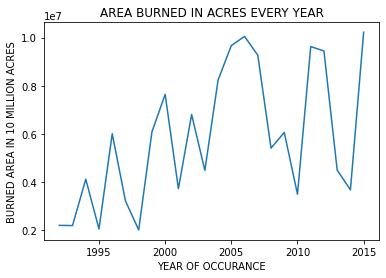

In [ ]:
x_axis = [val[0] for val in temp.select('FIRE_YEAR').collect()]
y_axis = [val[0] for val in temp.select('sum').collect()]

print(x_axis)
plt.plot(x_axis,y_axis)
plt.title('AREA BURNED IN ACRES EVERY YEAR')
plt.xlabel('YEAR OF OCCURANCE')
plt.ylabel('BURNED AREA IN 10 MILLION ACRES')
plt.show()

# AREA BURNED IN ACRES EVERY YEAR
IT WAS NOTICED THAT THE FOREST HAVE A TEMPORARY PEAK IN INCREASE IN WILDFIRES BEFORE THEY CAN REGENERATE WHICH CAUSES A TEMPORARY LIMBO OR REDUCTION IN THE AMOUNT OF WILDFIRES FOR SOME YEARS BEFORE THE FOREST CAN REGENERATE COMPLETELY AND THEN THE CYCLE REPEATS ITSELF ACCORDINGLY

In [ ]:
sparkdf.show()

+----------+---------+--------------------------+----------------+---------+-----------+-------------+-----+
| FIRE_NAME|FIRE_YEAR|SOURCE_REPORTING_UNIT_NAME|STAT_CAUSE_DESCR|FIRE_SIZE|   LATITUDE|    LONGITUDE|STATE|
+----------+---------+--------------------------+----------------+---------+-----------+-------------+-----+
|  FOUNTAIN|     2005|      Plumas National F...|   Miscellaneous|      0.1|40.03694444|-121.00583333|   CA|
|    PIGEON|     2004|      Eldorado National...|       Lightning|     0.25|38.93305556|-120.40444444|   CA|
|     SLACK|     2004|      Eldorado National...|  Debris Burning|      0.1|38.98416667|-120.73555556|   CA|
|      DEER|     2004|      Eldorado National...|       Lightning|      0.1|38.55916667|-119.91333333|   CA|
|  STEVENOT|     2004|      Eldorado National...|       Lightning|      0.1|38.55916667|-119.93305556|   CA|
|    HIDDEN|     2004|      Eldorado National...|       Lightning|      0.1|38.63527778|-120.10361111|   CA|
|      FORK|     20

In [ ]:
sparkdf.select("STAT_CAUSE_DESCR").distinct().show()


temp = sparkdf.groupby(sparkdf.STAT_CAUSE_DESCR).sum()
temp = temp.withColumnRenamed("sum(FIRE_SIZE)", "sum").sort("sum")
temp.show()


+-----------------+
| STAT_CAUSE_DESCR|
+-----------------+
|    Miscellaneous|
|          Smoking|
|        Lightning|
|         Campfire|
|            Arson|
|   Debris Burning|
|         Railroad|
|        Powerline|
|Missing/Undefined|
|        Structure|
|         Children|
|        Fireworks|
|    Equipment Use|
+-----------------+

+-----------------+--------------+--------------------+--------------------+--------------------+
| STAT_CAUSE_DESCR|sum(FIRE_YEAR)|                 sum|       sum(LATITUDE)|      sum(LONGITUDE)|
+-----------------+--------------+--------------------+--------------------+--------------------+
|    Miscellaneous|     649331273|1.4394204201972745E7| 1.212782890711749E7|-3.09439233556645...|
|          Smoking|     105858079|   842660.5221999458|  1979206.6599779837|  -4943519.007145206|
|        Lightning|     557844978|   8.7033501016713E7|1.0972559546781246E7|-3.013756282514252E7|
|         Campfire|     152561765|  3429061.4610009594|   3008273.27728

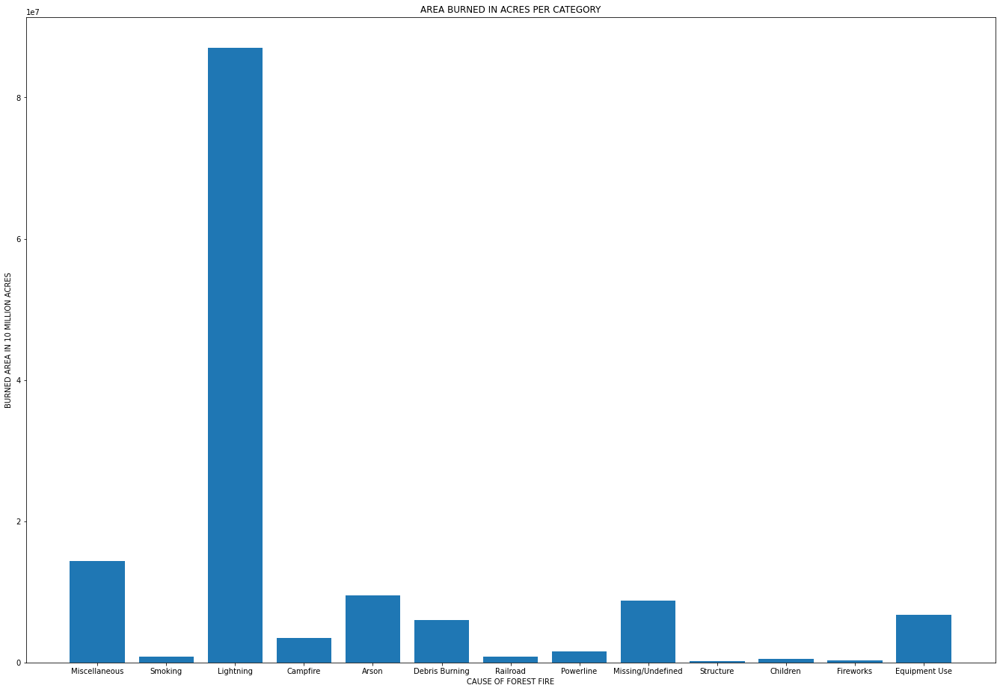

In [ ]:
fig = plt.figure()
ax = fig.add_axes([0,0,3,3])
x_axis = [i[0] for i in sparkdf.select("STAT_CAUSE_DESCR").distinct().collect()]
y_axis = [i[0] for i in temp.select("sum").collect()]
ax.bar(x_axis,y_axis)
plt.title('AREA BURNED IN ACRES PER CATEGORY')
plt.xlabel('CAUSE OF FOREST FIRE')
plt.ylabel('BURNED AREA IN 10 MILLION ACRES')
plt.show()

# CAUSES OF FIRE

### WILDFIRES CAN BE DIVIDED INTO 2 SEPERATE CATEGORIES:
1. HUMAN CAUSED WILDFIRES (PREVENTABLE) e.g. FIREWORKS, RAILROADS, POWERLINE, SMOKING
2. NON HUMAN CAUSED WILDFIRES (NON PREVENTABLE) e.g. LIGHTNING

WHILE THE CAUSE OF THE **NATURAL** WILDFIRES MAY NOT BE MANY BUT THEIR IMPACT MAKES UP ABOUT **50%** OF TOTAL WILDFIRES AT ALMOST **8 MILLION ACRES** OF LAND BURNT BETWEEN 1992 AND 2015 THESE ARE FIRES THAT CANNOT BE PREVENTED.

THE MAJOR CONCERN IS ABOUT FIRES THAT CAN BE PREVENTED AND THEY INCLUDE THE WILDFIRES CAUSED DUE TO **HUMAN** INTERVENTION, A MAJOR FACTOR BEING **ARSON** WHICH IS **100%** PREVENTABLE IF AWARENESS IS SPREAD.

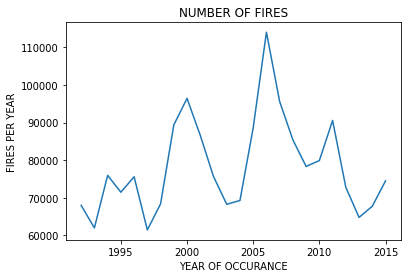

In [ ]:
from pyspark.sql.functions import lit
sparkdf = sparkdf.withColumn('count', lit(1))
here = sparkdf.select("FIRE_YEAR", "count")
here = here.withColumn('count', f.count('count').over(Window.partitionBy( sparkdf.FIRE_YEAR))).distinct().sort("FIRE_YEAR")

x_axis = [val[0] for val in here.select('FIRE_YEAR').collect()]
y_axis = [val[0] for val in here.select('count').collect()]

plt.plot(x_axis,y_axis)
plt.title('NUMBER OF FIRES')
plt.xlabel('YEAR OF OCCURANCE')
plt.ylabel('FIRES PER YEAR')
plt.show()

# NUMBERS OF FIRES SPREAD
THE NUMBER OF FIRES ALSO HAS THE VERY SAME IMPACT AS THE AREA BURNED WHICH CONFIRMS TO OUR LOGIC OF FOREST REGENERATION

In [ ]:
here = sparkdf.select("FIRE_SIZE", "count")
  
here.withColumn('count', f.count('count').over(Window.partitionBy( sparkdf.FIRE_SIZE))).distinct().sort("FIRE_SIZE").show(25)

+---------+-----+
|FIRE_SIZE|count|
+---------+-----+
|   1.0E-5|    1|
|   9.0E-5|    1|
|   1.0E-4|   13|
|   2.0E-4|    4|
|   2.2E-4|    1|
|   3.4E-4|    2|
|   4.0E-4|    1|
|  4.59E-4|    1|
|   8.0E-4|    1|
|   9.0E-4|    1|
|    0.001|  130|
|  0.00138|    1|
|  0.00159|    1|
|   0.0016|    1|
|    0.002|   22|
|   0.0025|    1|
|   0.0027|    1|
|    0.003|   32|
|    0.004|    8|
|    0.005|   17|
|    0.006|    2|
|   0.0062|    1|
|   0.0068|    1|
|    0.007|    5|
|    0.008|    3|
+---------+-----+
only showing top 25 rows



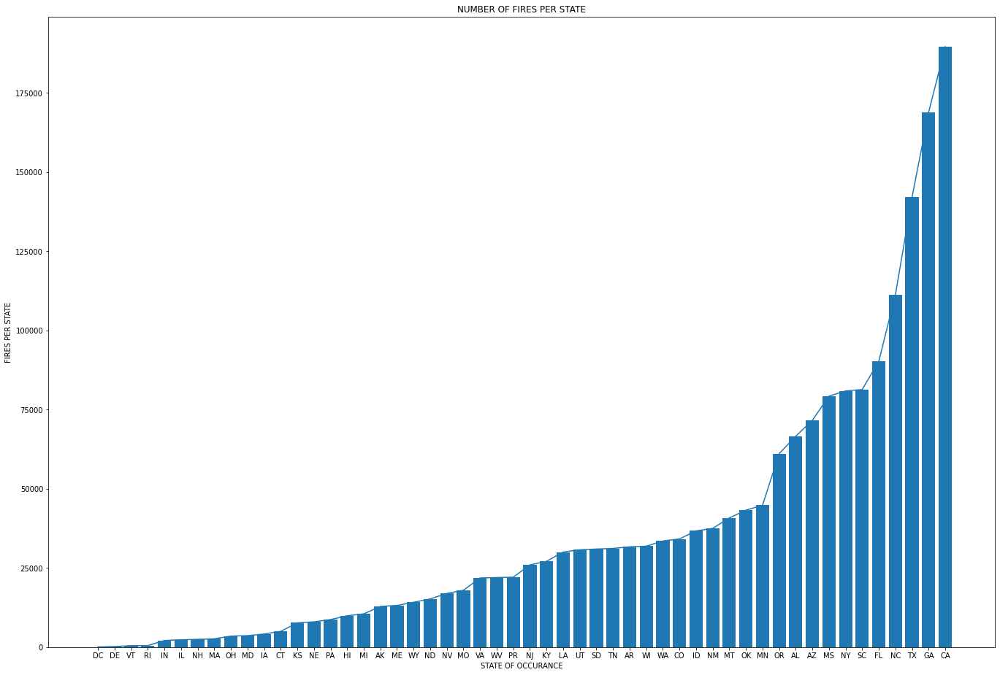

In [ ]:
fig2 = plt.figure()
ax = fig2.add_axes([0,0,3,3])
here = sparkdf.select("STATE", "count")
here = here.withColumn('count', f.count('count').over(Window.partitionBy( sparkdf.STATE))).distinct().sort("count")
x_axis = [val[0] for val in here.select('STATE').collect()]
y_axis = [val[0] for val in here.select('count').collect()]

ax.bar(x_axis,y_axis)
plt.plot(x_axis,y_axis)
plt.title('NUMBER OF FIRES PER STATE')
plt.xlabel('STATE OF OCCURANCE')
plt.ylabel('FIRES PER STATE')
plt.show()

# NUMBER OF FIRES PER STATE
THE TREND OF FIRES SPREAD PER STATE BY COUNT IS SIMPLE AND MAKES SENSE WHERE MOST OF WARM AND DRY STATES LIKE **CALIFORNIA, GEORGIA, TEXAS, NORTH CAROLINA AND FLORIDA** ARE TOP CONTRIBUTORS TO THE NUMBER OF FIRES THAT OCCURED IRRESPECTIVE OF SIZE.

ANOTHER SURPRISING FACTOR IS THAT MOST OF THE **TOP 10 STATES** COME FROM THE **WEST COAST** OF USA.

A SURPRISING FACTOR IS THAT **CALIFORNIA** HAS THE SAME AMOUNT OF FIRES AS THAT OF THE **BOTTOM 20** IN THE LIST COMBINED

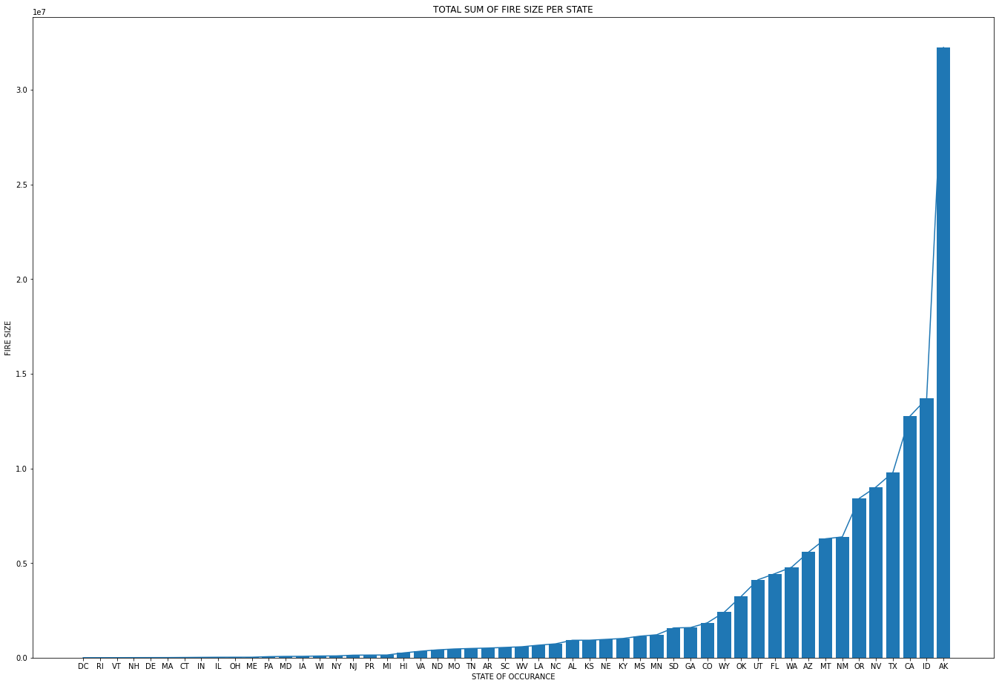

In [ ]:
temp = sparkdf.groupby(sparkdf.STATE).sum()
temp = temp.withColumnRenamed("sum(FIRE_SIZE)", "sum").sort("sum")

fig2 = plt.figure()
ax = fig2.add_axes([0,0,3,3])
x_axis = [val[0] for val in temp.select('STATE').collect()]
y_axis = [val[0] for val in temp.select('sum').collect()]

ax.bar(x_axis,y_axis)
plt.plot(x_axis,y_axis)
plt.title('TOTAL SUM OF FIRE SIZE PER STATE')
plt.xlabel('STATE OF OCCURANCE')
plt.ylabel('FIRE SIZE')
plt.show()


# TOTAL SUM OF FIRE SIZE BURNED AND TRENDS

IT IS NOTICED THAT **ALASKA, IDAHO, CALIFORNIA, TEXAS, NEVADA** ARE THE TOP 5 CONTRIBUTORS OF WILDFIRES IN USA

SAME TREND WAS OBSERVED WHERE THE **WEST COAST** CONTRIBUTED TO ALMOST ALL THE **TOP 10 CONTIBUTORS**

THERE WAS A MAJOR SURPRISE THAT WAS NOTICED AS A MATTER OF FACT **ALASKA** WITH ITS DRY BUT COLD TEMPERATURE WAS THE **LARGEST CONTRIBUTOR OF WILDFIRES AND WAS ABLE TO CONTRIBUTE MORE AREA IN HECTARES THAN THAT OF THE NEXT TWO STATES (IDAHO, CALIFORNIA) COMBINED.** 

"From 1950 until 2009, he said, forest fires in Alaska have released CO2 equal to half of all carbon emissions from the European Union."
-https://www.dw.com/en/forest-fires-in-alaska-a-ticking-climate-time-bomb/a-18684423

In [ ]:
sparkdf =spark.createDataFrame(data2) 
sparkdf.head(5)

[Row(FIRE_SIZE=0.1, DISCOVERY_DOY=33, STAT_CAUSE_DESCR='Miscellaneous'),
 Row(FIRE_SIZE=0.25, DISCOVERY_DOY=133, STAT_CAUSE_DESCR='Lightning'),
 Row(FIRE_SIZE=0.1, DISCOVERY_DOY=152, STAT_CAUSE_DESCR='Debris Burning'),
 Row(FIRE_SIZE=0.1, DISCOVERY_DOY=180, STAT_CAUSE_DESCR='Lightning'),
 Row(FIRE_SIZE=0.1, DISCOVERY_DOY=180, STAT_CAUSE_DESCR='Lightning')]

In [ ]:
from pyspark.sql.functions import lit

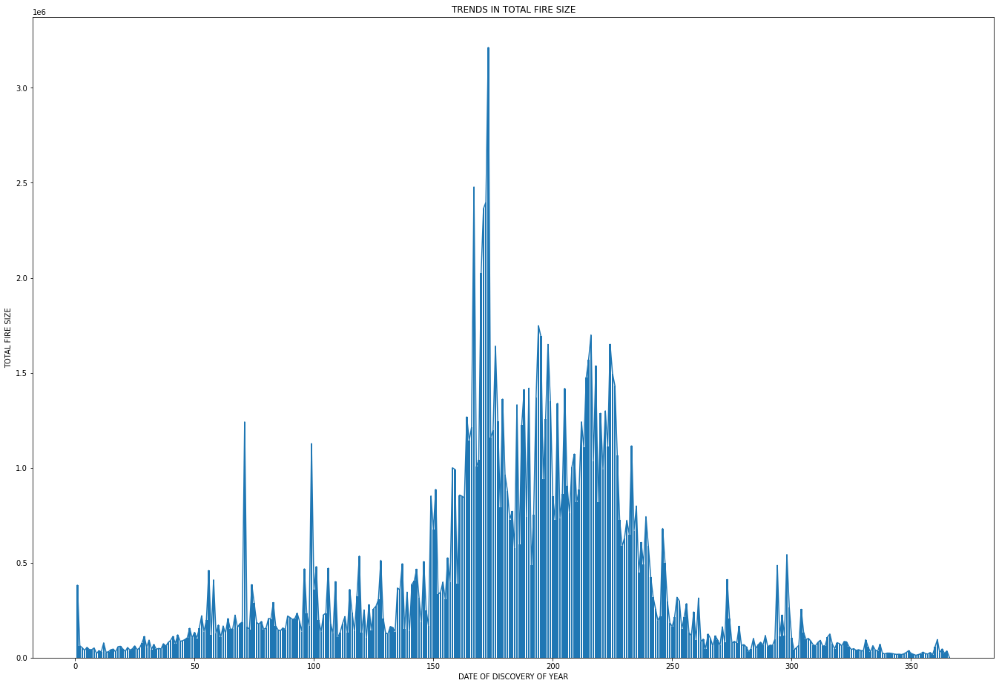

In [ ]:
sparkdf

fig2 = plt.figure()
ax = fig2.add_axes([0,0,3,3])

temp = sparkdf.withColumn('count', lit(1))
temp = temp.groupby(sparkdf.DISCOVERY_DOY).sum()

temp = temp.withColumnRenamed("sum(FIRE_SIZE)", "sum").sort("DISCOVERY_DOY")

x_axis = [val[0] for val in temp.select('DISCOVERY_DOY').collect()]
y_axis = [val[0] for val in temp.select('sum').collect()]

ax.bar(x_axis,y_axis)
plt.plot(x_axis,y_axis)
plt.title('TRENDS IN TOTAL FIRE SIZE')
plt.xlabel('DATE OF DISCOVERY OF YEAR')
plt.ylabel('TOTAL FIRE SIZE')
plt.show()



# TRENDS IN WILDFIRE SPREAD BY AREA BURNED IN HECTARES


THERE IS A STRICT CORELATION AMONG ALL THE YEARS WHERE THE FIRE SEASON STARTS FROM **DAY 150 AND LASTS UNTIL DAY 250 **WITH WILDFIRES RAGING AT EXTREME EXTENTS.
THESE DATE TO THE **START OF JUNE TO MID SEPTEMBER**

ANOTHER OBSERVATION WAS MADE THAT THERE WAS A OUT OF CONTEXT INCRESE IN WILDFIRES IN OCTOBER END(HALOWEEN) AND JANUARY START(NEW YEAR) AND ON MARCH MID(TEXAS INDEPENDANCE DAY) AND APRIL START (SUMMERFEST)
CORELATION BETWEEN THESE EVENTS AND WILDFIRES IS STUDIED IN DETAIL IN FOLLOWING SECTIONS.


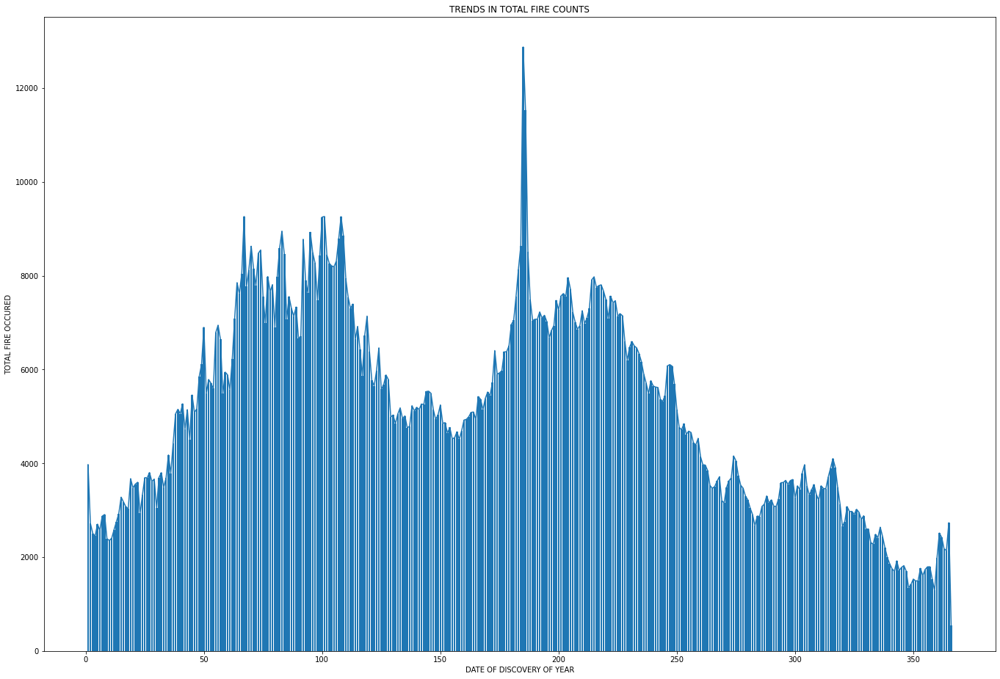

In [ ]:
#temp.show()
fig2 = plt.figure()
ax = fig2.add_axes([0,0,3,3])

temp = temp.withColumnRenamed("sum(count)", "count")

x_axis = [val[0] for val in temp.select('DISCOVERY_DOY').collect()]
y_axis = [val[0] for val in temp.select('count').collect()]

ax.bar(x_axis,y_axis)
plt.plot(x_axis,y_axis)
plt.title('TRENDS IN TOTAL FIRE COUNTS')
plt.xlabel('DATE OF DISCOVERY OF YEAR')
plt.ylabel('TOTAL FIRE OCCURED')
plt.show()

# TRENDS IN FIRE COUNTS
FOLLOWS THE SAME DISTRIBUTION AND CONFIRMS TO THE THEORY OF FIREOWRK CORELATION MUCH MORE ROBUSTLY

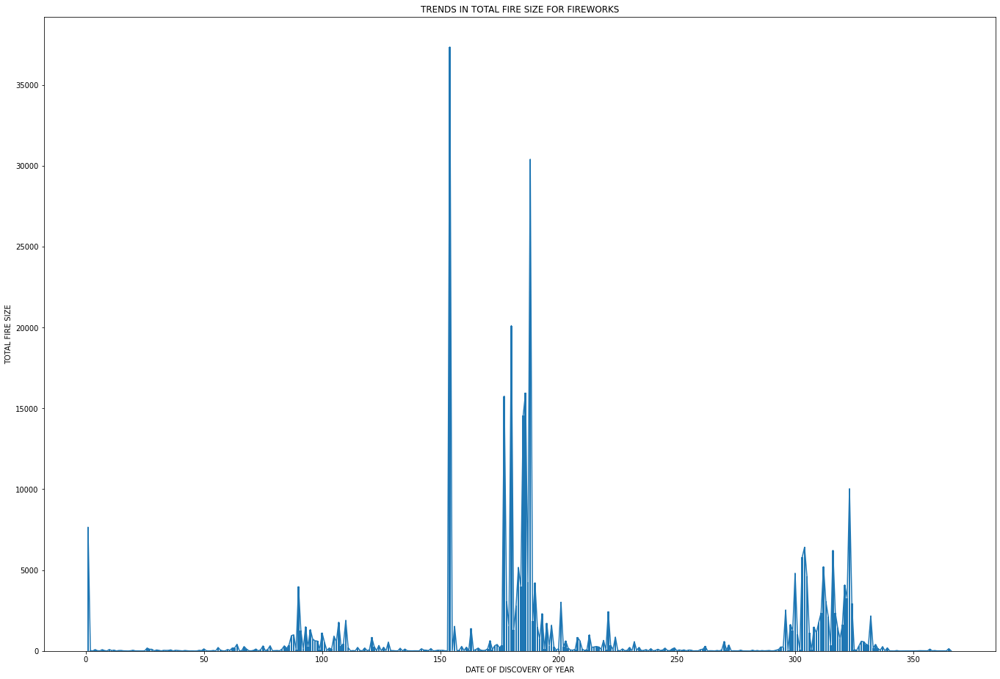

In [ ]:

fig2 = plt.figure()
ax = fig2.add_axes([0,0,3,3])
temp = sparkdf.select(sparkdf.DISCOVERY_DOY,sparkdf.FIRE_SIZE,sparkdf.STAT_CAUSE_DESCR).filter(sparkdf.STAT_CAUSE_DESCR== "Fireworks").withColumn('count', lit(1))
temp = temp.groupby(sparkdf.DISCOVERY_DOY).sum()

temp = temp.withColumnRenamed("sum(FIRE_SIZE)", "sum").sort("DISCOVERY_DOY")

x_axis = [val[0] for val in temp.select('DISCOVERY_DOY').collect()]
y_axis = [val[0] for val in temp.select('sum').collect()]

ax.bar(x_axis,y_axis)
plt.plot(x_axis,y_axis)
plt.title('TRENDS IN TOTAL FIRE SIZE FOR FIREWORKS')
plt.xlabel('DATE OF DISCOVERY OF YEAR')
plt.ylabel('TOTAL FIRE SIZE')
plt.show()

# STUDY ON FIREWORK RELATED EVENTS BY COUNT

IT IS CLEARLY VISIBLE THAT INFERENCE FROM THE FILDFIRE SPREAD BY AREA BURNED IN HEXTARES IS COMPLETELY TRUE ABOUT THE FIREWORK CORELATION.
IT WAS ALSO NOTICED THAT AT THE START OF JULY THERE WERE A LOT OF WILDFIRES CAUSED DUE TO FIREWORKS, THERE IS A CLEAR CORELATION WITH **4TH OF JULY** AND FIREWORK INCIDENTS AS THERE IS A HUGE PEAK AT THAT POINT.

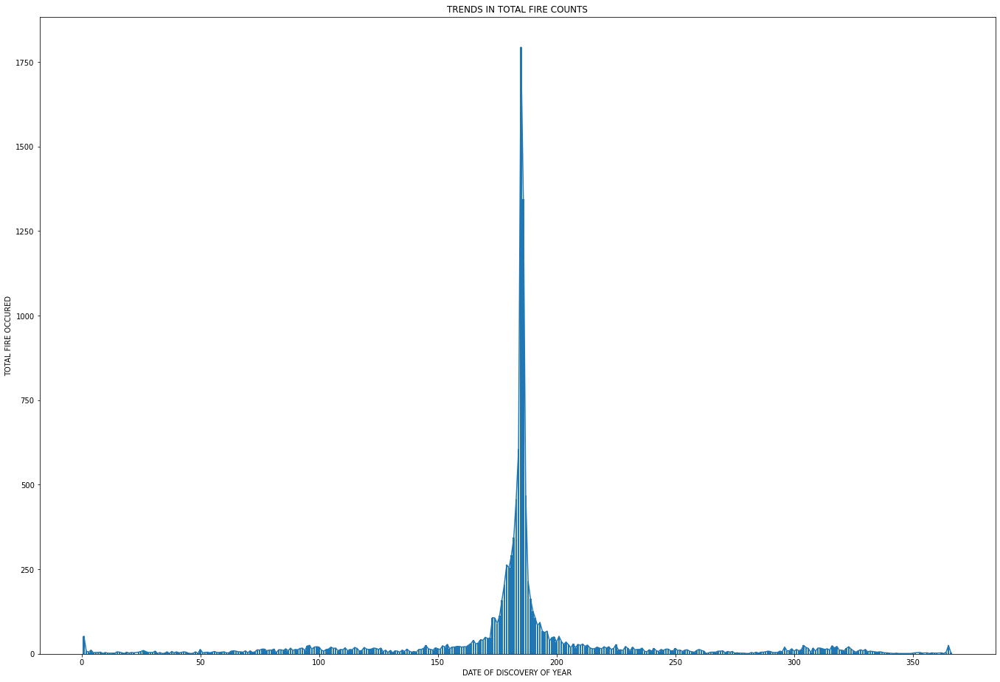

In [ ]:
fig2 = plt.figure()
ax = fig2.add_axes([0,0,3,3])

temp = temp.withColumnRenamed("sum(count)", "count")

x_axis = [val[0] for val in temp.select('DISCOVERY_DOY').collect()]
y_axis = [val[0] for val in temp.select('count').collect()]

ax.bar(x_axis,y_axis)
plt.plot(x_axis,y_axis)
plt.title('TRENDS IN TOTAL FIRE COUNTS')
plt.xlabel('DATE OF DISCOVERY OF YEAR')
plt.ylabel('TOTAL FIRE OCCURED')
plt.show()

# AREA BURNED IN HECTARES IN FIREWORKK RELATED EVENTS

THERE WAS A CLEAR CORELATION BETWEEN FIRE SPREAD AND TIMESPAN OF LATE JUNE AND MID JULY, THIS IS THE PERIOD WHERE FIRECRACKER SALE IS PERMITTED IN SEVERAL STATES.

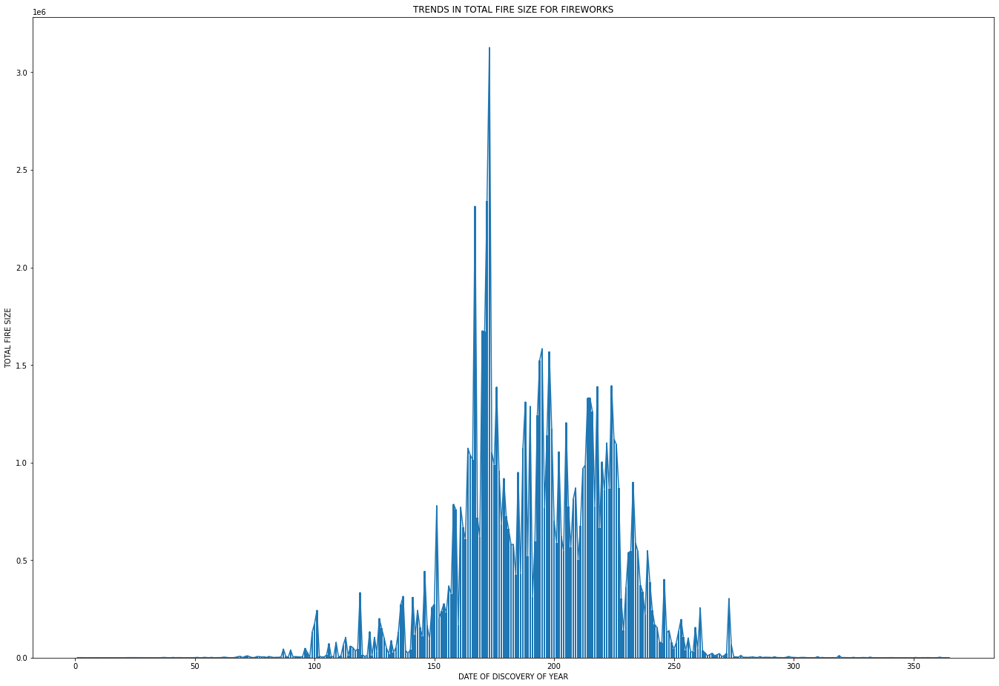

In [ ]:

fig2 = plt.figure()
ax = fig2.add_axes([0,0,3,3])
temp = sparkdf.select(sparkdf.DISCOVERY_DOY,sparkdf.FIRE_SIZE,sparkdf.STAT_CAUSE_DESCR).filter(sparkdf.STAT_CAUSE_DESCR== "Lightning").withColumn('count', lit(1))
temp = temp.groupby(sparkdf.DISCOVERY_DOY).sum()

temp = temp.withColumnRenamed("sum(FIRE_SIZE)", "sum").sort("DISCOVERY_DOY")

x_axis = [val[0] for val in temp.select('DISCOVERY_DOY').collect()]
y_axis = [val[0] for val in temp.select('sum').collect()]

ax.bar(x_axis,y_axis)
plt.plot(x_axis,y_axis)
plt.title('TRENDS IN TOTAL FIRE SIZE FOR LIGHTNING')
plt.xlabel('DATE OF DISCOVERY OF YEAR')
plt.ylabel('TOTAL FIRE SIZE')
plt.show()

# TRENDS IN TOTAL FIRE SIZE FOR LIGHTNING
THERE IS A CLEAR CORELATION AS TO WHY THERE IS AN INCRESE IN THE SEASONS DISCUSSED ABOVE.
LIGHTNING IN THE MAJOR CAUSE OF WILDFIRES AND THE WARM AND DRY CLIMATE SERVES AS THE CORRECT STARTER FOR OCEANIC WINDS TO FILL UP ITS PLACE BRINGING RAIN AND LIGHTNING, HOWEVER IN ARID CLIMATES OF WEST COAST THERE IS LITTLE TO NO RAIN, THIS IS A HUGELY UNAVOIDABLE PROBLEM FOR THE WILDFIRE DEPARTMENT.

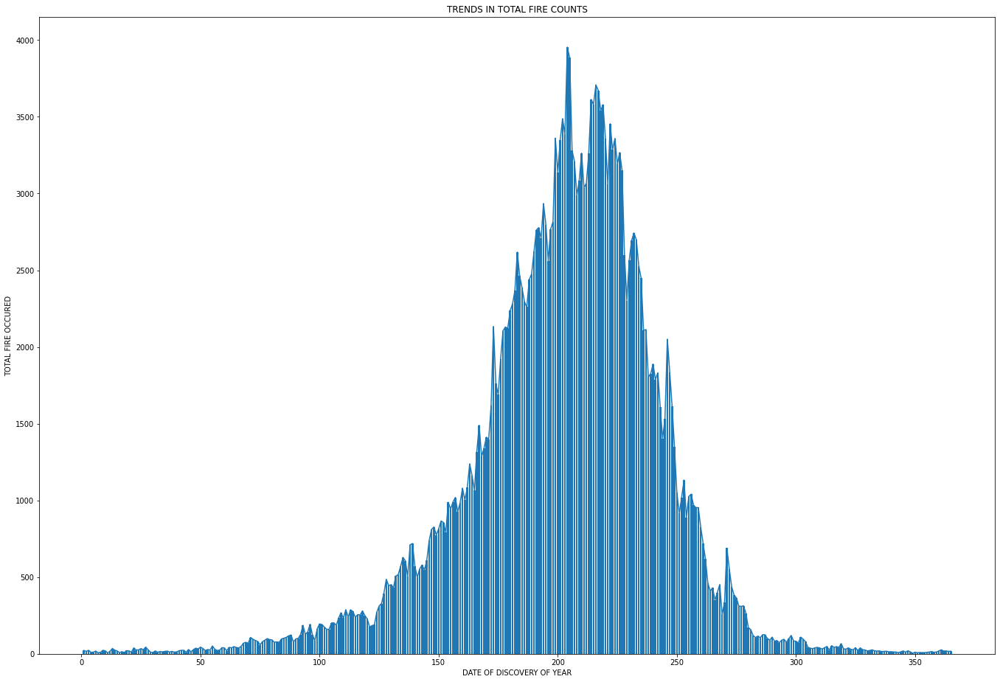

In [ ]:
fig2 = plt.figure()
ax = fig2.add_axes([0,0,3,3])

temp = temp.withColumnRenamed("sum(count)", "count")

x_axis = [val[0] for val in temp.select('DISCOVERY_DOY').collect()]
y_axis = [val[0] for val in temp.select('count').collect()]

ax.bar(x_axis,y_axis)
plt.plot(x_axis,y_axis)
plt.title('TRENDS IN TOTAL FIRE COUNTS')
plt.xlabel('DATE OF DISCOVERY OF YEAR')
plt.ylabel('TOTAL FIRE OCCURED')
plt.show()

In [ ]:
print(min(data['FIRE_SIZE']))
print(max(data['FIRE_SIZE']))

1e-05
606945.0



# FIONA BASED MAPS TO VISUALIZE WILDFIRE TRENDS

In [ ]:
data = data.loc[data['FIRE_SIZE'] > 100]

In [ ]:
m = folium.Map(location = [40.44, -104.81],
               tiles = 'Stamen Terrain',
               zoom_start = 6)



Class_A = folium.FeatureGroup(name = '1,000 Acres to 10,000 Acres - Class D')
Class_B = folium.FeatureGroup(name = '10,000 Acres to 50,000 Acres - Class E')
Class_C = folium.FeatureGroup(name = 'More than 50,000 Acres - Class G')



for i, v in data.iterrows():
    
    size = float(v['FIRE_SIZE'])
    
    popup = """
    Name : %s<br>
    Size : %s<br>
    State : %s<br>
    Cause : %s<br>
    Year: %s<br>
    """ % (v['FIRE_NAME'], v['FIRE_SIZE'], 
           v['STATE'], v['STAT_CAUSE_DESCR'], 
           v['FIRE_YEAR'])
    
    
        
    if size in range(1000, 10000):
        folium.CircleMarker(location = [v['LATITUDE'], 
                                        v['LONGITUDE']],
                           radius = np.log(size),
                           weight = 0,
                           tooltip = popup,
                           color = '#feb24c',
                           fill_color = '#feb24c',
                           fill_opacity = 0.5,
                           fill = True).add_to(Class_A)
    
    if size in range(10000, 50000):
        folium.CircleMarker(location = [v['LATITUDE'], 
                                        v['LONGITUDE']],
                           radius = np.log(size)*1.4,
                           weight = 0,
                           tooltip = popup,
                           color = '#fc4e2a',
                           fill_color = '#fc4e2a',
                           fill_opacity = 0.6,
                           fill = True).add_to(Class_B)

    if size > 50000:
        folium.CircleMarker(location = [v['LATITUDE'], 
                                        v['LONGITUDE']],
                           radius = np.log(size)*1.8,
                           weight = 0,
                           tooltip = popup,
                           color = '##b10026',
                           fill_color = '#b10026',
                           fill_opacity = 0.7,
                           fill = True).add_to(Class_C)

Class_A.add_to(m)
Class_B.add_to(m)
Class_C.add_to(m)
folium.LayerControl(collapsed = False).add_to(m)

m

In [ ]:
m = folium.Map(location = [40.44, -104.81],
               tiles = 'Stamen Terrain',
               zoom_start = 6)



Class_A = folium.FeatureGroup(name = '500 Acres to 1,000 Acres - Class D')

for i, v in data.iterrows():
    
    size = float(v['FIRE_SIZE'])
    
    popup = """
    Name : %s<br>
    Size : %s<br>
    State : %s<br>
    Cause : %s<br>
    Year: %s<br>
    """ % (v['FIRE_NAME'], v['FIRE_SIZE'], 
           v['STATE'], v['STAT_CAUSE_DESCR'], 
           v['FIRE_YEAR'])
    
    
        
    if size in range(500, 1000):
        folium.CircleMarker(location = [v['LATITUDE'], 
                                        v['LONGITUDE']],
                           radius = np.log(size),
                           weight = 0,
                           tooltip = popup,
                           color = '#feb24c',
                           fill_color = '#feb24c',
                           fill_opacity = 0.5,
                           fill = True).add_to(Class_A)

Class_A.add_to(m)
folium.LayerControl(collapsed = False).add_to(m)

m

In [ ]:
m = folium.Map(location = [40.44, -104.81],
               tiles = 'Stamen Terrain',
               zoom_start = 6)



Class_A = folium.FeatureGroup(name = '500 Acres to 1,000 Acres - Class D')

for i, v in data.iterrows():
    
    size = float(v['FIRE_SIZE'])
    
    popup = """
    Name : %s<br>
    Size : %s<br>
    State : %s<br>
    Cause : %s<br>
    Year: %s<br>
    """ % (v['FIRE_NAME'], v['FIRE_SIZE'], 
           v['STATE'], v['STAT_CAUSE_DESCR'], 
           v['FIRE_YEAR'])
    
    
        
    if size in range(300, 500):
        folium.CircleMarker(location = [v['LATITUDE'], 
                                        v['LONGITUDE']],
                           radius = np.log(size),
                           weight = 0,
                           tooltip = popup,
                           color = '#feb24c',
                           fill_color = '#feb24c',
                           fill_opacity = 0.5,
                           fill = True).add_to(Class_A)

Class_A.add_to(m)
folium.LayerControl(collapsed = False).add_to(m)

m

In [ ]:
map_hooray = folium.Map(location=[40.44, -104.81],tiles = 'Stamen Terrain',
                    zoom_start = 5) 

data['LATITUDE'] = data['LATITUDE'].astype(float)
data['LONGITUDE'] = data['LONGITUDE'].astype(float)
heat_data = data.loc[data['FIRE_SIZE'] > 1000]
heat_data = data[['LATITUDE', 'LONGITUDE']]
heat_data = heat_data.dropna(axis=0, subset=['LATITUDE','LONGITUDE'])

heat= [[row['LATITUDE'],row['LONGITUDE']] for index, row in heat_data.iterrows()]

HeatMap(heat).add_to(map_hooray)

map_hooray

In [ ]:
data = data.loc[data['STAT_CAUSE_DESCR'] == "Fireworks"]

In [ ]:
map_hooray = folium.Map(location=[40.44, -104.81],tiles = 'Stamen Terrain',
                    zoom_start = 5) 

data['LATITUDE'] = data['LATITUDE'].astype(float)
data['LONGITUDE'] = data['LONGITUDE'].astype(float)
heat_data = data.loc[data['FIRE_SIZE'] > 1000]
heat_data = data[['LATITUDE', 'LONGITUDE']]
heat_data = heat_data.dropna(axis=0, subset=['LATITUDE','LONGITUDE'])

heat= [[row['LATITUDE'],row['LONGITUDE']] for index, row in heat_data.iterrows()]

HeatMap(heat).add_to(map_hooray)

map_hooray